In [3]:
!pip install umap

  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Created wheel for umap: filename=umap-0.1.1-py3-none-any.whl size=3550 sha256=18bc3385a3d197d30054fa607006bfde39976502e61d89dad547595e06938f58
  Stored in directory: c:\users\mp155\appdata\local\pip\cache\wheels\48\4a\1c\1d511cbb0413a448d8546e958f8e82b98d9bb493038d19ece2
Successfully built umap


In [5]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import umap
from sklearn import metrics
from sklearn.cluster import DBSCAN, HDBSCAN
from tqdm import tqdm
from sklearn.mixture import GaussianMixture
import pandas as pd
import plotly.graph_objects as go
import plotly.express as px

In [21]:
hgtnpy = np.load('./data/source_data/PV_hgt_data_DJF_256.npy', mmap_mode='r')

In [22]:
pvnpy = np.load('./data/source_data/PV_pv_data_DJF_256.npy', mmap_mode='r')

In [23]:
mask = np.load('./data/source_data/mask_256.npy')

In [24]:
mask = mask.astype(bool)

In [11]:
embeddings = np.load('checkpoint_0090-embeddings.npy')

In [13]:
embeddings.shape

(21476, 64)

In [15]:
reducer = umap.UMAP(n_components=2, n_neighbors=10)

AttributeError: module 'umap' has no attribute 'UMAP'

In [6]:
xx = reducer.fit_transform(embeddings)

In [7]:
subset_idx = np.random.choice(np.arange(0, embeddings.shape[0]), 5000, replace=False)

In [8]:
xx_subset = xx[subset_idx]
embeddings_subset = embeddings[subset_idx]

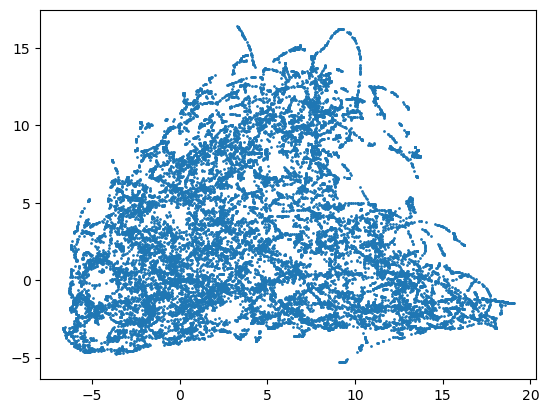

In [9]:
plt.scatter(xx[:,0], xx[:,1], s=1);

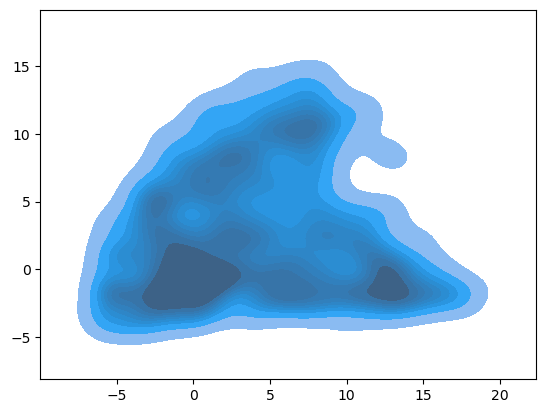

In [10]:
sns.kdeplot(x=xx[:,0], y=xx[:,1], fill=True);

In [11]:
db = DBSCAN(eps=0.4, min_samples=15)

In [12]:
db.fit(xx)

DBSCAN(eps=0.4, min_samples=15)

In [13]:
labels = db.labels_

In [14]:
np.unique(labels)

array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
       16, 17, 18], dtype=int64)

In [15]:
metrics.silhouette_score(xx, labels)

-0.4432125

In [16]:
centroids_2d = [xx[labels==l].mean(axis=0) for l in np.unique(labels)[1:]]

In [17]:
centroids_2d = [c[np.newaxis,:] for c in centroids_2d]

In [18]:
centroids_2d = np.concatenate(centroids_2d, axis=0)
centroids_2d.shape

(19, 2)

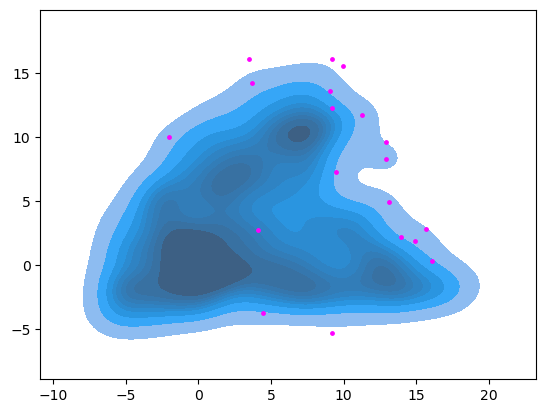

In [19]:
sns.kdeplot(x=xx_subset[:,0], y=xx_subset[:,1], fill=True)
plt.scatter(centroids_2d[:,0], centroids_2d[:,1], c='magenta', s=6, marker='o')

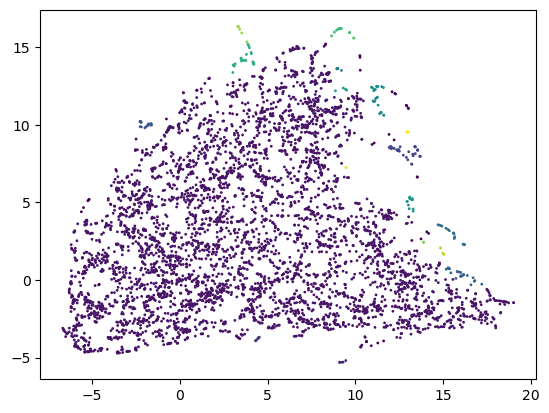

In [20]:
plt.scatter(xx_subset[:,0], xx_subset[:,1], s=1, c=labels[subset_idx]);

In [27]:
cluster_hgt_means = {}
for c in tqdm(np.unique(labels)[1:]):
    cluster_subset = hgtnpy[labels==c]
    cluster_mean_hgt = cluster_subset.mean(axis=0)
    cluster_hgt_means[c] = cluster_mean_hgt

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [01:13<00:00,  3.85s/it]


In [44]:
cluster_counts = {}
for c in np.unique(labels)[1:]:
    cluster_count = (labels==c).sum()
    cluster_counts[c] = cluster_count

In [28]:
len(np.unique(labels)[1:])

19

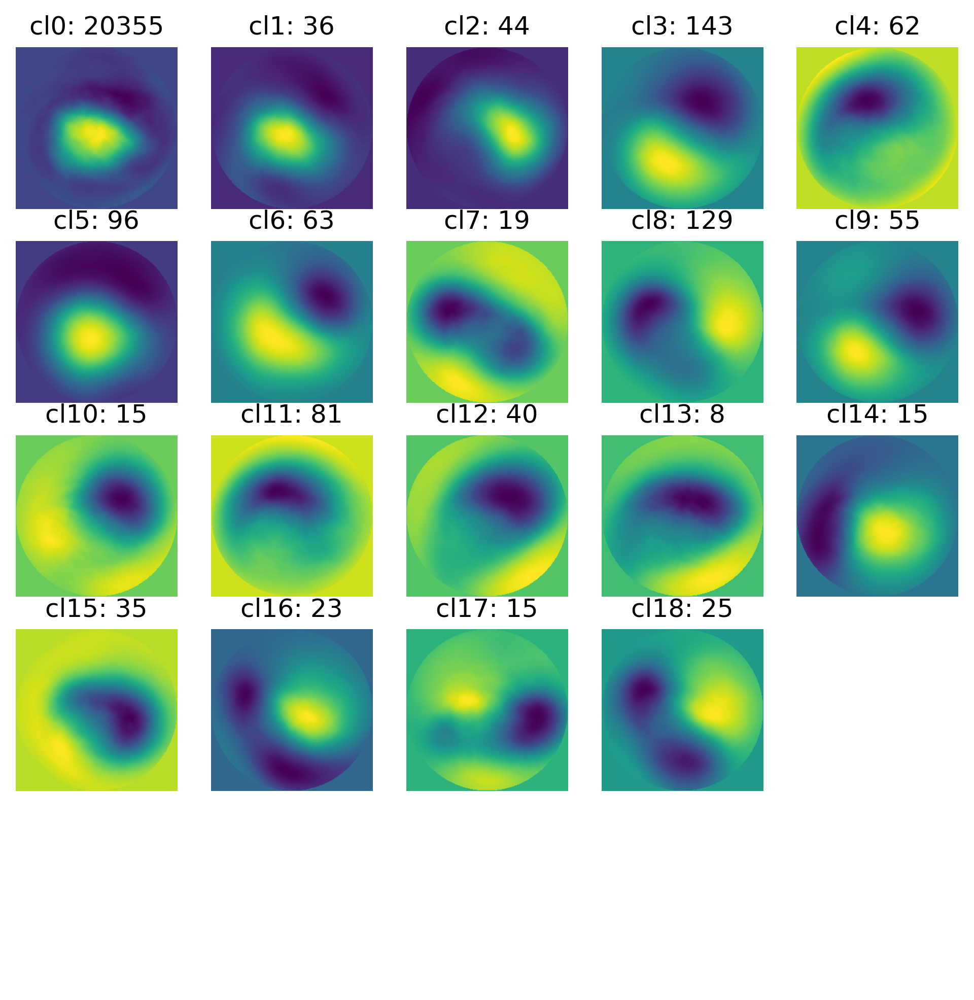

In [46]:
f = plt.figure(figsize=(8,8), dpi=300)
idx = 0
for r in range(5):
    for c in range(5):
        p = plt.subplot(5,5,r*5+c+1)
        if idx in np.unique(labels)[1:].tolist():
            plt.imshow(cluster_hgt_means[idx])
            plt.title(f"cl{idx}: {cluster_counts[idx]}")
        plt.axis('off')
        idx += 1

In [47]:
gm = GaussianMixture(n_components=5).fit(xx)

In [48]:
labels_gm = gm.predict(xx)

In [49]:
np.unique(labels_gm)

array([0, 1, 2, 3, 4], dtype=int64)

In [50]:
centroids_2d_gm = [xx[labels_gm==l].mean(axis=0) for l in np.unique(labels_gm)]

In [51]:
centroids_2d_gm = [c[np.newaxis,:] for c in centroids_2d_gm]

In [52]:
centroids_2d_gm = np.concatenate(centroids_2d_gm, axis=0)
centroids_2d_gm.shape

(5, 2)

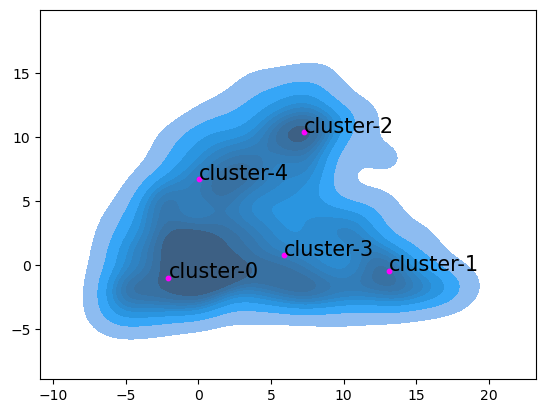

In [69]:
sns.kdeplot(x=xx_subset[:,0], y=xx_subset[:,1], fill=True)
plt.scatter(centroids_2d_gm[:,0], centroids_2d_gm[:,1], c='magenta', s=10, marker='o')
for centroid, cl_num in zip(centroids_2d_gm, np.unique(labels_gm)):
    plt.text(centroid[0], centroid[1], f"cluster-{cl_num}", fontdict={"fontsize": 15})

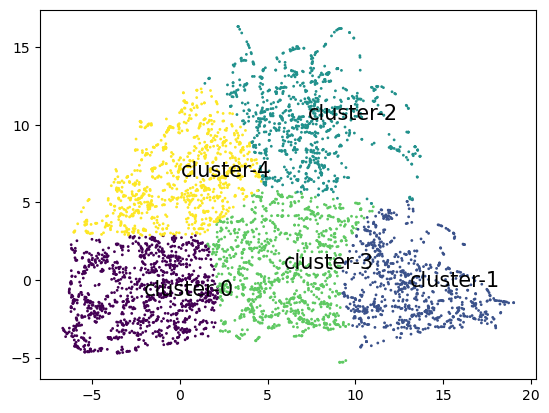

In [70]:
plt.scatter(xx_subset[:,0], xx_subset[:,1], s=1, c=labels_gm[subset_idx]);
for centroid, cl_num in zip(centroids_2d_gm, np.unique(labels_gm)):
    plt.text(centroid[0], centroid[1], f"cluster-{cl_num}", fontdict={"fontsize": 15})

In [54]:
metrics.silhouette_score(xx, labels_gm)

0.4015854

In [57]:
cluster_hgt_means_gm = {}
for c in tqdm(np.unique(labels_gm)):
    cluster_subset = hgtnpy[labels_gm==c]
    cluster_mean_hgt = cluster_subset.mean(axis=0)
    cluster_hgt_means_gm[c] = cluster_mean_hgt

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:30<00:00,  6.13s/it]


In [63]:
cluster_counts_gm = {}
for c in np.unique(labels_gm):
    cluster_count = (labels_gm==c).sum()
    cluster_counts_gm[c] = cluster_count

In [64]:
len(np.unique(labels_gm))

5

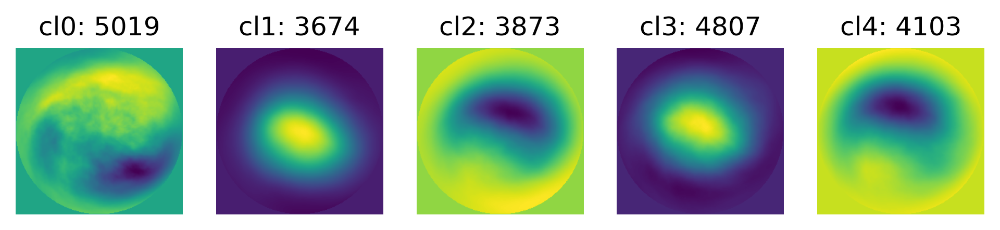

In [66]:
f = plt.figure(figsize=(8,8), dpi=300)
idx = 0
for r in range(5):
    p = plt.subplot(1,5,r+1)
    if idx in np.unique(labels_gm).tolist():
        plt.imshow(cluster_hgt_means_gm[idx])
        plt.title(f"cl{idx}: {cluster_counts_gm[idx]}")
    plt.axis('off')
    idx += 1

In [71]:
def gm_clustering_score(embeddings, n_components=4):
    gm = GaussianMixture(n_components=n_components)
    gm.fit(embeddings)
    labels = gm.predict(embeddings)
    score = metrics.silhouette_score(embeddings, labels)
    return score, labels

исследуем качество кластеризации в зависимости от `n_components`

In [72]:
results = []
for n_components in tqdm(range(2, 21), total=19):
    score, labels = gm_clustering_score(xx, n_components=n_components)
    results.append({"n_components": n_components,
                    "labels": labels,
                    "score": score})

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [01:49<00:00,  5.76s/it]


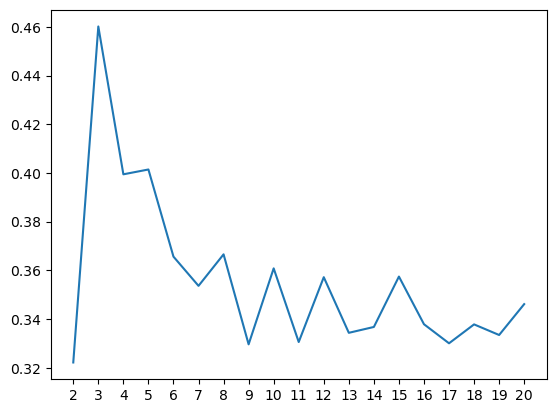

In [73]:
plt.plot([r['n_components'] for r in results], [r['score'] for r in results])
plt.xticks([r['n_components'] for r in results]);

In [75]:
gm_scores = pd.DataFrame(results)

<Axes: >

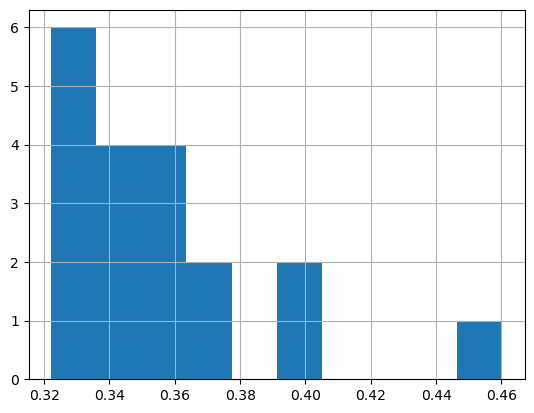

In [76]:
gm_scores.score.hist()

In [77]:
gm_scores.score.max()

0.4601770341396332

In [78]:
labels_gm = gm_scores.iloc[gm_scores['score'].idxmax(), :]['labels']

In [79]:
centroids_2d_gm = [xx[labels_gm==l].mean(axis=0) for l in np.unique(labels_gm)]

In [80]:
centroids_2d_gm = [c[np.newaxis,:] for c in centroids_2d_gm]

In [81]:
centroids_2d_gm = np.concatenate(centroids_2d_gm, axis=0)
centroids_2d_gm.shape

(3, 2)

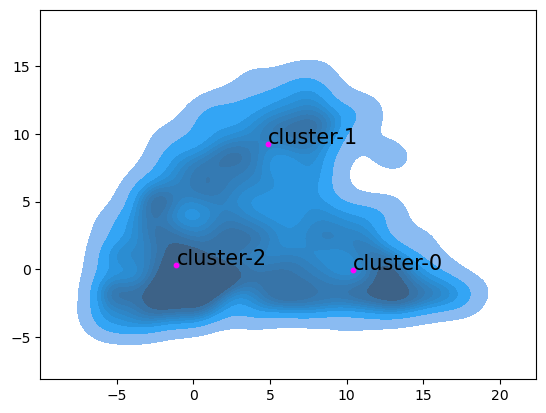

In [82]:
sns.kdeplot(x=xx[:,0], y=xx[:,1], fill=True)
plt.scatter(centroids_2d_gm[:,0], centroids_2d_gm[:,1], c='magenta', s=10, marker='o')
for centroid, cl_num in zip(centroids_2d_gm, np.unique(labels_gm)):
    plt.text(centroid[0], centroid[1], f"cluster-{cl_num}", fontdict={"fontsize": 15})

In [83]:
cluster_hgt_means_gm = {}
for c in tqdm(np.unique(labels_gm)):
    cluster_subset = hgtnpy[labels_gm==c]
    cluster_mean_hgt = cluster_subset.mean(axis=0)
    cluster_hgt_means_gm[c] = cluster_mean_hgt

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:43<00:00, 14.35s/it]


In [84]:
cluster_counts_gm = {}
for c in np.unique(labels_gm):
    cluster_count = (labels_gm==c).sum()
    cluster_counts_gm[c] = cluster_count

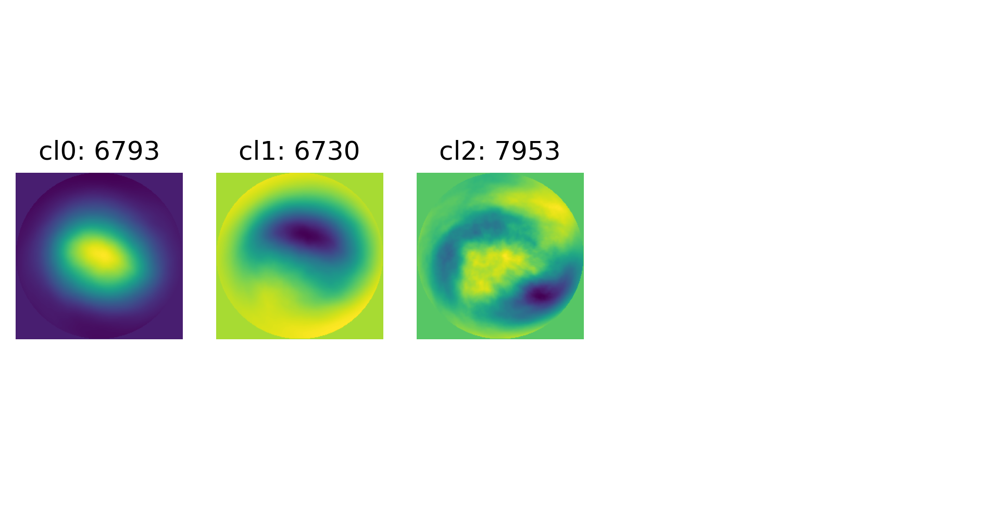

In [86]:
f = plt.figure(figsize=(8,4), dpi=300)
idx = 0
for r in range(5):
    p = plt.subplot(1,5,r+1)
    if idx in np.unique(labels_gm).tolist():
        plt.imshow(cluster_hgt_means_gm[idx])
        plt.title(f"cl{idx}: {cluster_counts_gm[idx]}")
    plt.axis('off')
    idx += 1

In [88]:
xx,yy = np.meshgrid(np.arange(0, 256), np.arange(0, 256))

Text(0.5, 0, 'HGT: cluster-0')

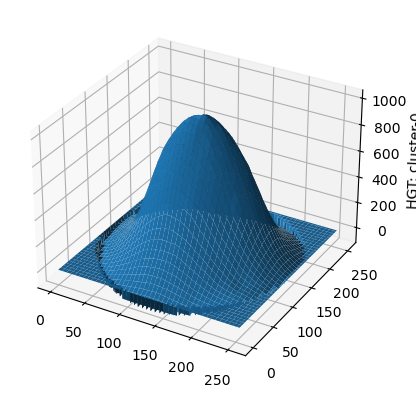

In [89]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(xx, yy, cluster_hgt_means_gm[0])
ax.set_zlabel('HGT: cluster-0')

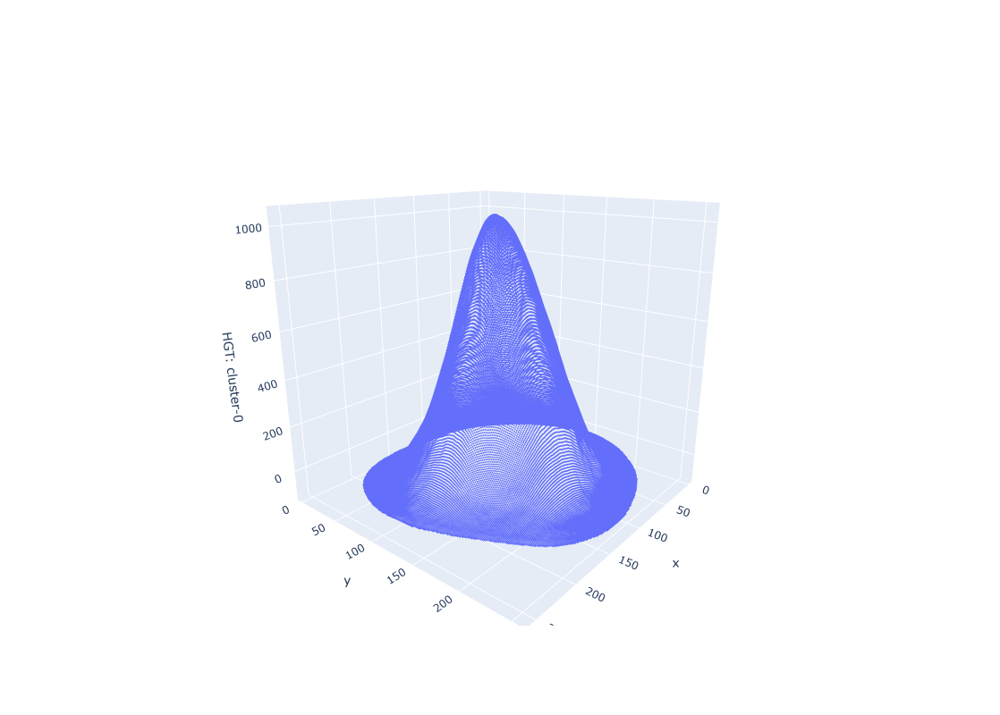

In [92]:
fig = go.Figure(data=[go.Scatter3d(x=xx[mask].ravel(),
                                   y=yy[mask].ravel(),
                                   z=cluster_hgt_means_gm[0][mask].ravel(),
                                   mode='markers',
                                   marker=dict(size=1))
                     ])
fig.update_layout(autosize=False,
                  width=800,
                  height=800,
                  margin=go.layout.Margin(l=50, r=50, b=100, t=100, pad=4),
                  scene = dict(xaxis_title='x',
                               yaxis_title='y',
                               zaxis_title='HGT: cluster-0'))
fig.show()

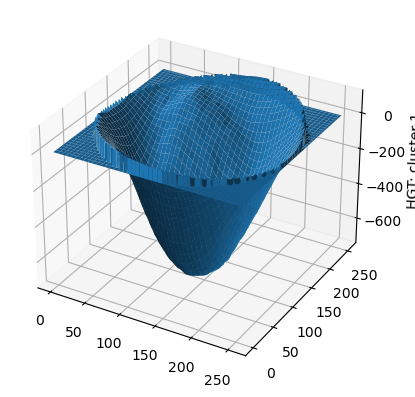

In [94]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(xx, yy, cluster_hgt_means_gm[1])
ax.set_zlabel('HGT: cluster-1');

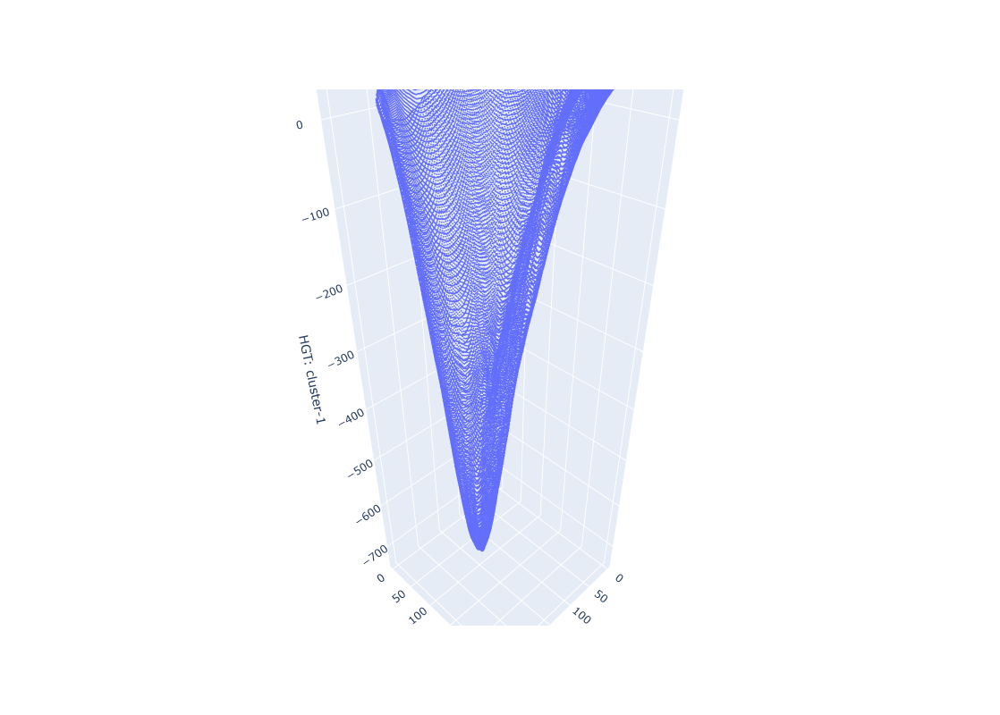

In [95]:
fig = go.Figure(data=[go.Scatter3d(x=xx[mask].ravel(),
                                   y=yy[mask].ravel(),
                                   z=cluster_hgt_means_gm[1][mask].ravel(),
                                   mode='markers',
                                   marker=dict(size=1))
                     ])
fig.update_layout(autosize=False,
                  width=800,
                  height=800,
                  margin=go.layout.Margin(l=50, r=50, b=100, t=100, pad=4),
                  scene = dict(xaxis_title='x',
                               yaxis_title='y',
                               zaxis_title='HGT: cluster-1'))
fig.show()

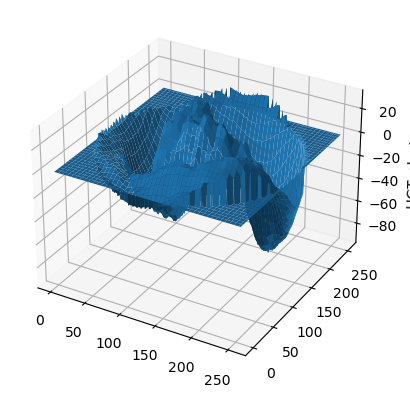

In [96]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(xx, yy, cluster_hgt_means_gm[2])
ax.set_zlabel('HGT: cluster-2');

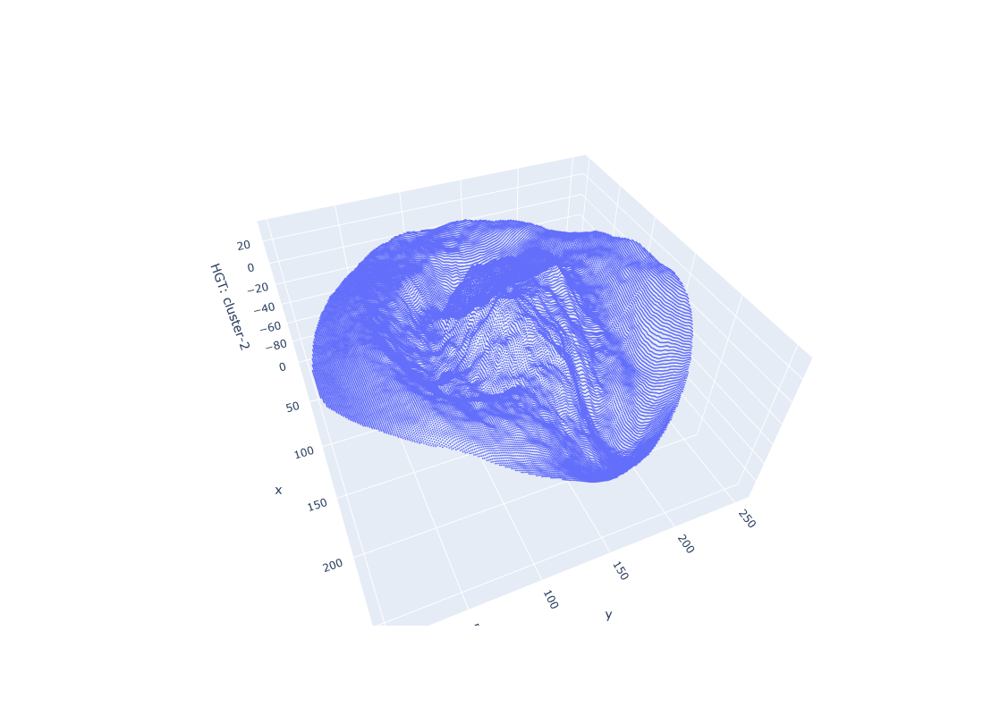

In [97]:
fig = go.Figure(data=[go.Scatter3d(x=xx[mask].ravel(),
                                   y=yy[mask].ravel(),
                                   z=cluster_hgt_means_gm[2][mask].ravel(),
                                   mode='markers',
                                   marker=dict(size=1))
                     ])
fig.update_layout(autosize=False,
                  width=800,
                  height=800,
                  margin=go.layout.Margin(l=50, r=50, b=100, t=100, pad=4),
                  scene = dict(xaxis_title='x',
                               yaxis_title='y',
                               zaxis_title='HGT: cluster-2'))
fig.show()